# TODO NEEDS COMMENTS
# Example Structure for Features


In [1]:
# This cell imports necessary libraries and loads in data for analysis.

import organoid_prediction_python as opp
import skimage.io as io
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300

home_directory = r"C:\Users\savill\OneDrive\Documents\PhD Jesse\Embryonic_organoid_prediction\Processing dataset for Paper\TLS_2D_morphostate_investigation/"
table_location = home_directory + "tabular_data"

translation_frame = pd.read_csv("translation_dataframe_timepoints.csv")
name_mapping = {key:new_key for key,new_key in zip(translation_frame["original_names"],translation_frame["plot_names"])}

data = pd.read_csv(f"{table_location}/All_Samples_Feature_Space_All_Features_48h,72h,96h_Normalised_per_Timepoint.csv")


,Run,Plate,ID,048h_raw_BF_AreaShape_area,048h_raw_BF_AreaShape_aspect_ratio,048h_raw_BF_AreaShape_axis_major_length,048h_raw_BF_AreaShape_axis_minor_length,048h_raw_BF_AreaShape_eccentricity,048h_raw_BF_AreaShape_feret_diameter_max,048h_raw_BF_AreaShape_perimeter,...,096h_str_BF_AreaShape_moments_hu_1,096h_str_BF_AreaShape_moments_hu_2,096h_str_BF_AreaShape_moments_hu_3,096h_str_BF_AreaShape_moments_hu_4,096h_str_BF_AreaShape_moments_hu_5,096h_str_BF_AreaShape_moments_hu_6,096h_str_BF_AreaShape_orientation,096h_str_BF_AreaShape_perimeter,096h_str_CH_AreaShape_Bra_MajorAxis_Polarisation,096h_str_CH_AreaShape_Bra_MinorAxis_Polarisation
0,RR,1,A1,0.754091,-0.889636,0.132588,1.204628,-1.000051,0.007074,0.615519,...,-0.769984,-0.768314,-0.188818,-0.081040,-0.108285,-0.018937,0.218694,0.485603,-0.237483,0.204173
1,RR,1,A2,-0.783470,-1.252670,-1.238409,0.003129,-1.752936,-1.131530,-0.724230,...,-0.587974,0.518118,-0.142104,-0.080919,-0.108023,0.017986,-1.310831,-0.276812,-0.930821,1.071650
2,RR,1,A3,1.636441,-0.184192,1.186196,1.565451,-0.008740,1.127225,1.795347,...,-0.724302,-0.679043,-0.186519,-0.081045,-0.108504,-0.019001,-0.638784,0.014028,0.406917,-0.068697
3,RR,1,A4,-0.525754,-0.513477,-0.672134,-0.202863,-0.422446,-0.849309,-0.402853,...,0.276192,-0.326314,0.038707,-0.073034,-0.013521,0.038021,0.362758,0.652506,0.992505,-0.551399
4,RR,1,A5,0.537872,-0.248943,0.294790,0.612413,-0.084969,0.059492,0.498737,...,0.544892,-0.696050,-0.161387,-0.081127,-0.113141,-0.013480,-0.324894,-1.090064,0.285818,-0.643907
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
762,TR,2,H8,-0.342295,-0.103644,-0.319022,-0.266071,0.083062,-0.511010,-0.233997,...,-0.240030,1.252083,-0.031233,-0.076766,-0.095753,0.232280,-0.531978,0.936472,-1.056426,0.770934
763,TR,2,H9,-0.925432,1.281638,-0.116354,-1.536867,1.304509,-0.330223,-1.009869,...,-0.010842,0.858318,-0.018204,-0.084586,-0.137911,0.247706,0.371618,1.965908,0.143556,0.712064
764,TR,2,H10,-1.873304,-1.279234,-2.131125,-1.049808,-1.821515,-2.016265,-1.929328,...,-0.454779,1.044578,-0.117763,-0.082320,-0.115499,0.052699,0.177291,1.923294,-1.128242,-0.816051
765,TR,2,H11,-2.408392,-0.915375,-2.411391,-1.803167,-1.045366,-2.414625,-2.306480,...,1.523053,0.369209,0.161155,-0.101456,-0.309307,0.338411,-0.341009,1.652660,-0.982778,1.840169


In [2]:
# This code reads in a CSV file containing annotations with indices, and merges it with the data DataFrame.
# It then filters the data to remove unclassified Axes and Morphs, and drops any rows with missing values.
# Finally, it drops columns containing certain terms and returns the filtered DataFrame.

annotations = table_location + "/annotations_with_indices.csv"
annotation_df = pd.read_csv(annotations)
mapping = {"Real_Run":"RR", "Trial_Run":"TR"}
annotation_df["Run"] = [mapping[value] for value in annotation_df["Run"].to_numpy()]
no_na_annot = annotation_df[annotation_df["Morph_Class"]!="NA_NA"]

data_annotated = data.set_index(["Run","Plate","ID"]).merge(no_na_annot,on=["Run","Plate","ID"])

dat_filt = data_annotated[(data_annotated["Axes"] != "unclassified")&(data_annotated["Morph"] != "unclassified")]
dat_filt = dat_filt[dat_filt['048h_raw_BF_AreaShape_area'].notna()].dropna(axis=1).dropna()
dat_filt = dat_filt.drop([key for key in dat_filt.keys() if any([term in key for term in ["Location","orientation","_X","_Y","UMAP","PC"]])],axis=1)
dat_filt


,Run,Plate,ID,048h_raw_BF_AreaShape_area,048h_raw_BF_AreaShape_aspect_ratio,048h_raw_BF_AreaShape_axis_major_length,048h_raw_BF_AreaShape_axis_minor_length,048h_raw_BF_AreaShape_eccentricity,048h_raw_BF_AreaShape_feret_diameter_max,048h_raw_BF_AreaShape_perimeter,...,096h_str_BF_AreaShape_moments_hu_3,096h_str_BF_AreaShape_moments_hu_4,096h_str_BF_AreaShape_moments_hu_5,096h_str_BF_AreaShape_moments_hu_6,096h_str_BF_AreaShape_perimeter,096h_str_CH_AreaShape_Bra_MajorAxis_Polarisation,096h_str_CH_AreaShape_Bra_MinorAxis_Polarisation,Axes,Morph,Morph_Class
0,RR,1,A1,0.754091,-0.889636,0.132588,1.204628,-1.000051,0.007074,0.615519,...,-0.188818,-0.081040,-0.108285,-0.018937,0.485603,-0.237483,0.204173,single,good,single_good
1,RR,1,A2,-0.783470,-1.252670,-1.238409,0.003129,-1.752936,-1.131530,-0.724230,...,-0.142104,-0.080919,-0.108023,0.017986,-0.276812,-0.930821,1.071650,single,bad,single_bad
2,RR,1,A3,1.636441,-0.184192,1.186196,1.565451,-0.008740,1.127225,1.795347,...,-0.186519,-0.081045,-0.108504,-0.019001,0.014028,0.406917,-0.068697,single,bad,single_bad
3,RR,1,A4,-0.525754,-0.513477,-0.672134,-0.202863,-0.422446,-0.849309,-0.402853,...,0.038707,-0.073034,-0.013521,0.038021,0.652506,0.992505,-0.551399,single,good,single_good
4,RR,1,A5,0.537872,-0.248943,0.294790,0.612413,-0.084969,0.059492,0.498737,...,-0.161387,-0.081127,-0.113141,-0.013480,-1.090064,0.285818,-0.643907,single,bad,single_bad
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
429,TR,2,H4,-1.801231,0.189615,-1.378837,-1.801012,0.392510,-1.263560,-1.668959,...,-0.167413,-0.081086,-0.109219,-0.024483,1.594305,-0.631962,0.292950,single,good,single_good
430,TR,2,H5,-1.805599,0.135760,-1.400417,-1.768377,0.338334,-1.393948,-2.002972,...,0.473177,-0.022139,0.267669,0.200866,2.173369,1.316448,-0.919674,single,bad,single_bad
434,TR,2,H9,-0.925432,1.281638,-0.116354,-1.536867,1.304509,-0.330223,-1.009869,...,-0.018204,-0.084586,-0.137911,0.247706,1.965908,0.143556,0.712064,single,good,single_good
436,TR,2,H11,-2.408392,-0.915375,-2.411391,-1.803167,-1.045366,-2.414625,-2.306480,...,0.161155,-0.101456,-0.309307,0.338411,1.652660,-0.982778,1.840169,single,good,single_good


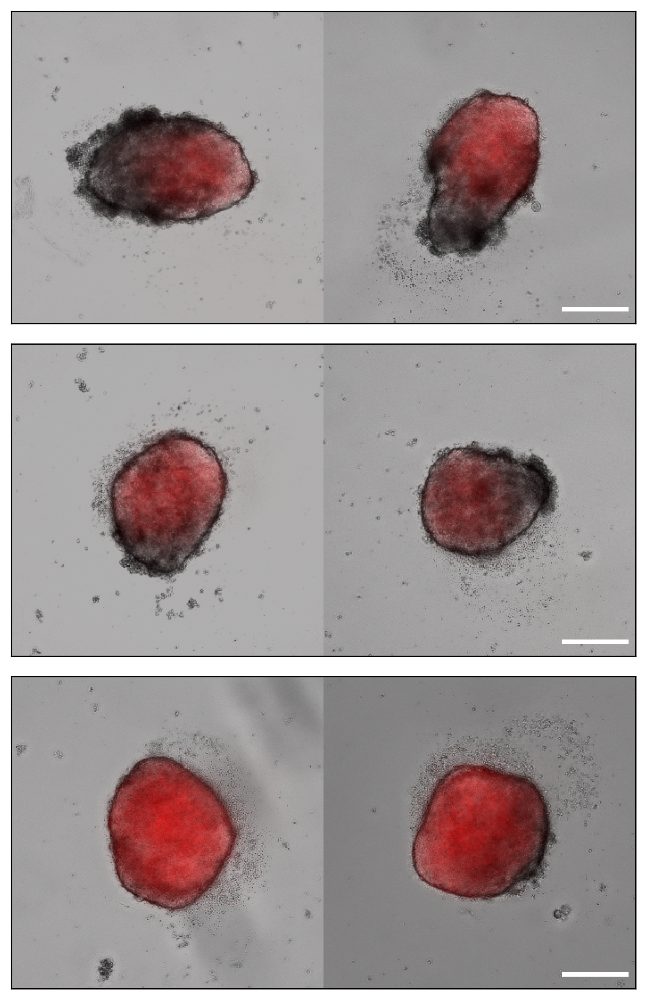

In [3]:
# This code imports necessary libraries and defines a font property.
from sklearn.neighbors import NearestNeighbors
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm
fontprops = fm.FontProperties(size=1)

# This code sets the data to be used and the image folder.
data = dat_filt
image_folder_96h_features = home_directory + "/image_data/Processed Data/Composites_Scaled_Across_Timepoints/"

# This code sets the number of examples to show and the hour to use.
n_examples = 2
hour = 96

# This code sets the feature to use and gets the values and indices.
feature = "096h_str_CH_AreaShape_Bra_MajorAxis_Polarisation"
values = data[feature].to_numpy()
indices = data.reset_index()[["Run","Plate","ID"]].to_numpy()

# This code sets the pixel size and calculates the quantiles.
pixel_size = 2.7493
quantiles = np.quantile(values,(0.05,0.95))
median = np.median(values)
high_med_low = [quantiles[1],median,quantiles[0]]

# This code gets the images for the high, median, and low values.
image_matrix = []
for val in high_med_low:
    k_closest = np.argsort(np.abs(values - val))[:n_examples]
    image_matrix.append([io.imread(image_folder_96h_features + f"Composite_Run_{index[0]}_Plate_{index[1]}_ID_{index[2]}_Hour_{hour}.tif") for index in indices[k_closest]])
image_matrix = np.array(image_matrix)

# This code sets the shape of the images and creates the subplots.
shape = image_matrix[0,0].shape
fi,axs = plt.subplots(3,figsize = (3*n_examples,9))

# This code shows the images and adds a scale bar to each.
for row in range(axs.shape[0]):
        axs[row].imshow(np.concatenate(image_matrix[row],axis=1),extent=[0,n_examples*shape[1]*pixel_size,0,shape[0]*pixel_size])
        axs[row].set_xticks([])
        axs[row].set_yticks([])
        scalebar = AnchoredSizeBar(axs[row].transData,
                           200,None, 'lower right', 
                           pad=5,
                           color='white',
                           frameon=False,
                           size_vertical=10,
                           fontproperties=fontprops)

        axs[row].add_artist(scalebar)
        
plt.tight_layout()

[1.7531488682451855, -0.1360873014502926, -1.5323491327492582]


array([['Run_RR_Plate_6_ID_A3_Hour_96', 'Run_RR_Plate_6_ID_H3_Hour_96'],
       ['Run_RR_Plate_1_ID_C4_Hour_96', 'Run_RR_Plate_4_ID_A7_Hour_96'],
       ['Run_RR_Plate_4_ID_D8_Hour_96', 'Run_TR_Plate_1_ID_C4_Hour_96']],
      dtype='<U28')

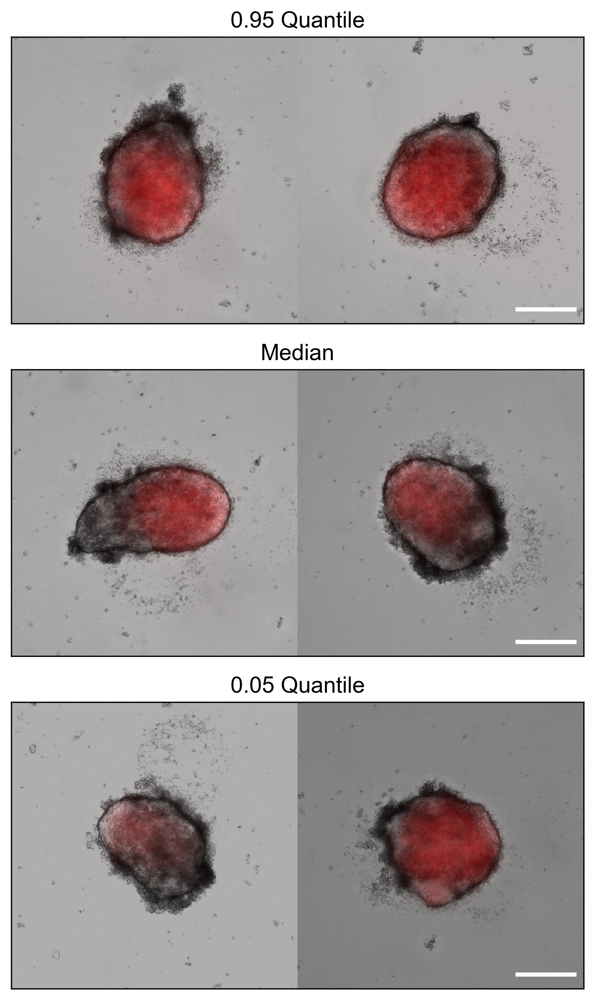

In [20]:
image_folder_96h_features = home_directory + "/image_data/Processed Data/Composites_Scaled_Across_Timepoints"
image_folder_72h_features = home_directory + "/image_data/Processed Data/Composites_Scaled_Across_48h-72h"

def make_example_structures_for_feature(
    data,
    feature,
    folder_96h,
    folder_72,
    out_folder = None,
    n_examples = 2,
    quantiles = (0.05,0.95),
    pixel_size = 2.7493,
    scale_bar_size = 200,
    scale_bar_height = 10,
    scale_bar_position = 'lower right',
):
    """
    Create example structures for a given feature.
    
    Parameters:
    -----------
    data : pandas.DataFrame
        The data to use.
    feature : str
        The feature to use.
    folder_96h : str
        The folder containing the 96h images.
    folder_72h : str
        The folder containing the 72h images.
    out_folder : str or None
        The folder to save the output to. If None, do not save.
    n_examples : int
        The number of examples to show.
    quantiles : tuple of floats
        The quantiles to use.
    pixel_size : float
        The pixel size.
    scale_bar_size : int
        The size of the scale bar.
    scale_bar_height : int
        The height of the scale bar.
    scale_bar_position : str
        The position of the scale bar.
    """
    if "96" in feature:
        hour = 96
        folder = folder_96h + "/"
    elif "72" in feature:
        hour=72
        folder = folder_72 + "/"
    elif "48" in feature:
        hour=48
        folder = folder_72 + "/"

    names = [f"{quantiles[1]} Quantile","Median",f"{quantiles[0]} Quantile",]
    values = data[feature].to_numpy()
    indices = data.reset_index()[["Run","Plate","ID"]].to_numpy()

    quantiles = np.quantile(values,quantiles)
    median = np.median(values)
    high_med_low = [quantiles[1],median,quantiles[0]]
    print(high_med_low)
    
    image_matrix = []
    for val in high_med_low:
        k_closest = np.argsort(np.abs(values - val))[:n_examples]
        image_matrix.append([io.imread(folder + f"Composite_Run_{index[0]}_Plate_{index[1]}_ID_{index[2]}_Hour_{hour}.tif") for index in indices[k_closest]])
    image_matrix = np.array(image_matrix)

    shape = image_matrix[0,0].shape
    fi,axs = plt.subplots(3,figsize = (3*n_examples,9))

    for row in range(axs.shape[0]):
            axs[row].imshow(np.concatenate(image_matrix[row],axis=1),extent=[0,n_examples*shape[1]*pixel_size,0,shape[0]*pixel_size])
            axs[row].set_xticks([])
            axs[row].set_yticks([])
            scalebar = AnchoredSizeBar(axs[row].transData,
                               scale_bar_size,None, scale_bar_position, 
                               pad=5,
                               color='white',
                               frameon=False,
                               size_vertical=scale_bar_height,
                               fontproperties=fontprops)

            axs[row].add_artist(scalebar)
            axs[row].set_title(names[row])

    plt.tight_layout()
    if not(out_folder is None):
        plt.savefig(f"{out_folder}/{feature} Example Structures ({n_examples} Examples, Scale Bar {scale_bar_size} um).pdf", format="pdf", bbox_inches="tight")
    
    Identity_matrix = []
    for val in high_med_low:
        k_closest = np.argsort(np.abs(values - val))[:n_examples]
        Identity_matrix.append([f"Run_{index[0]}_Plate_{index[1]}_ID_{index[2]}_Hour_{hour}" for index in indices[k_closest]])
    return np.array(Identity_matrix)
    
    
make_example_structures_for_feature(
    data,
    feature,
    folder_96h=image_folder_96h_features,
    folder_72=image_folder_72h_features,
    out_folder=None,
)


meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped


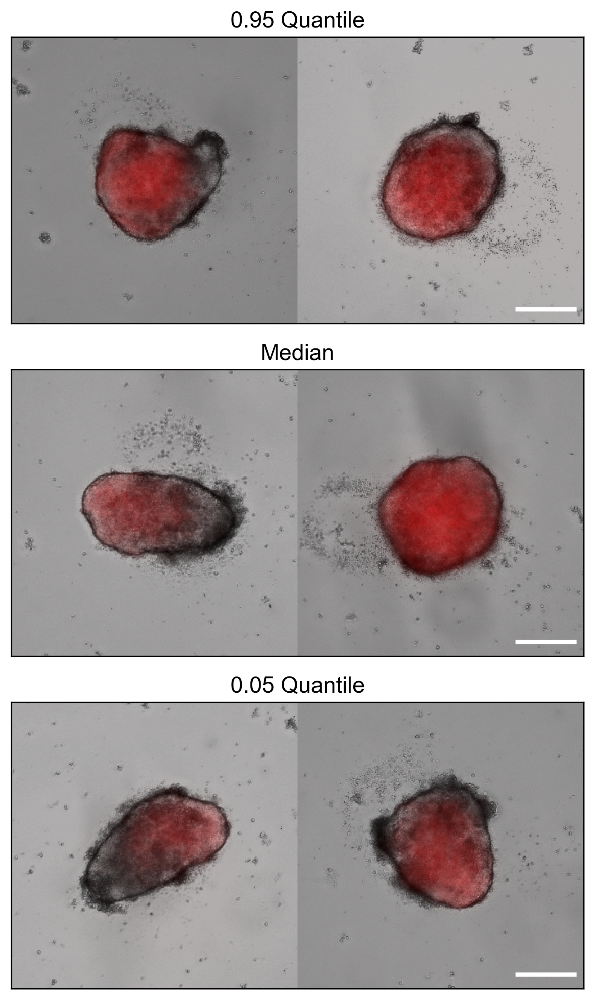

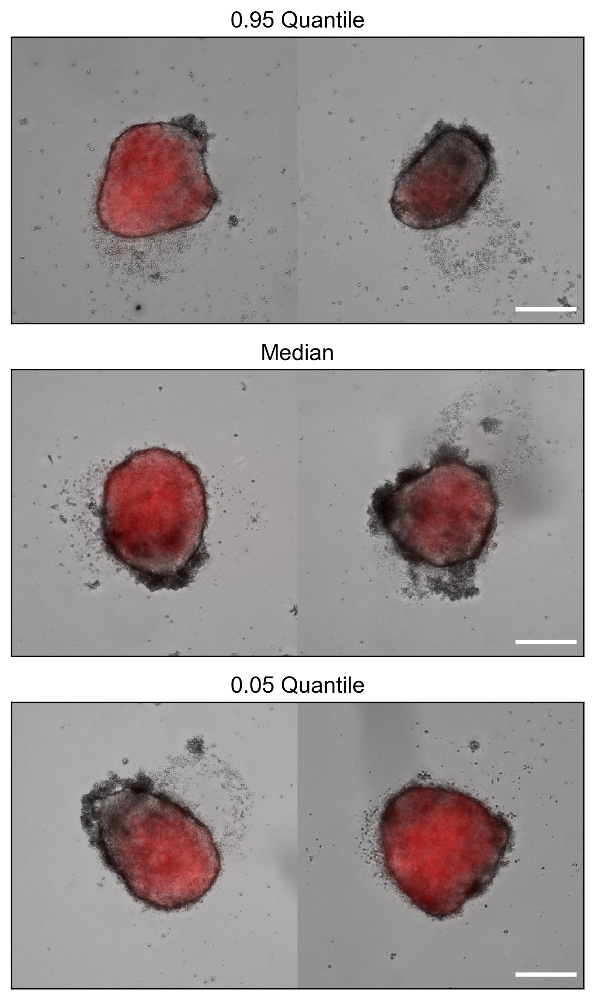

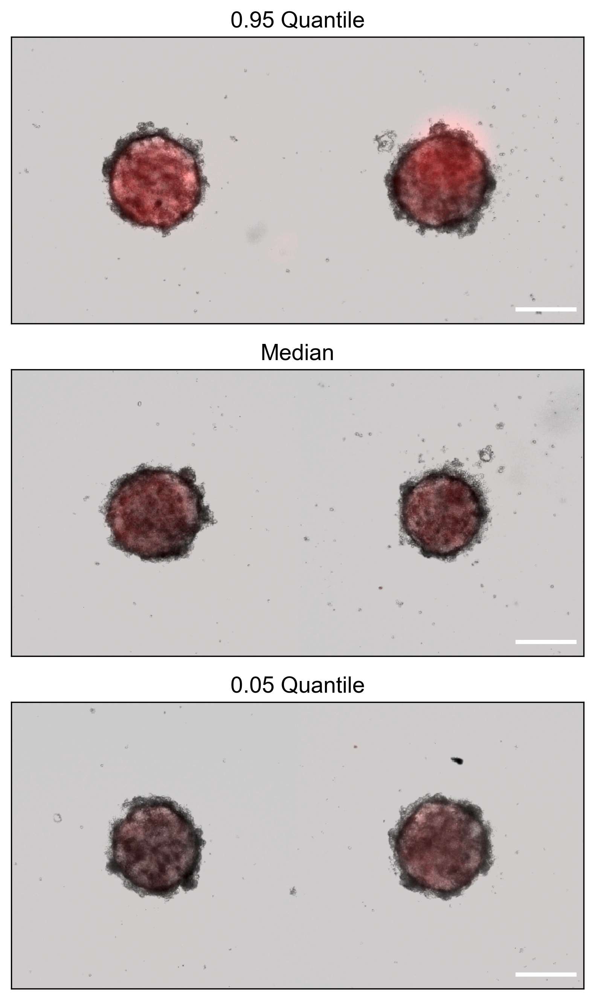

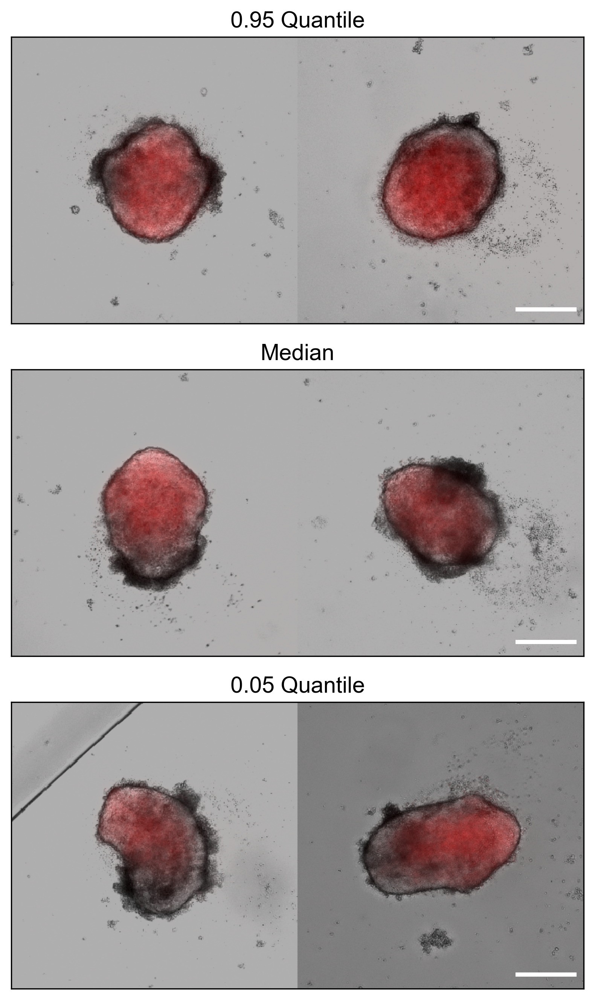

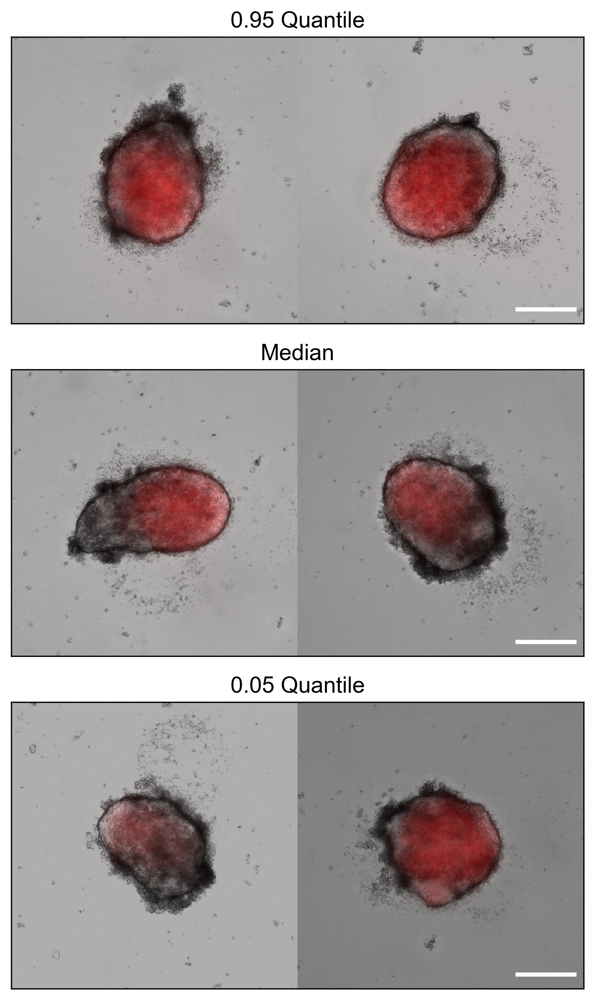

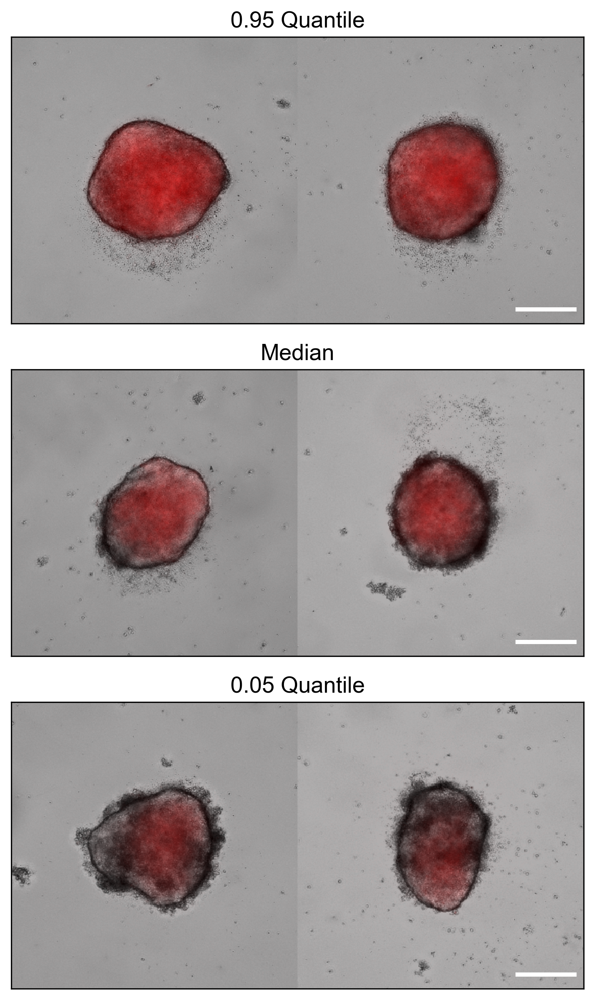

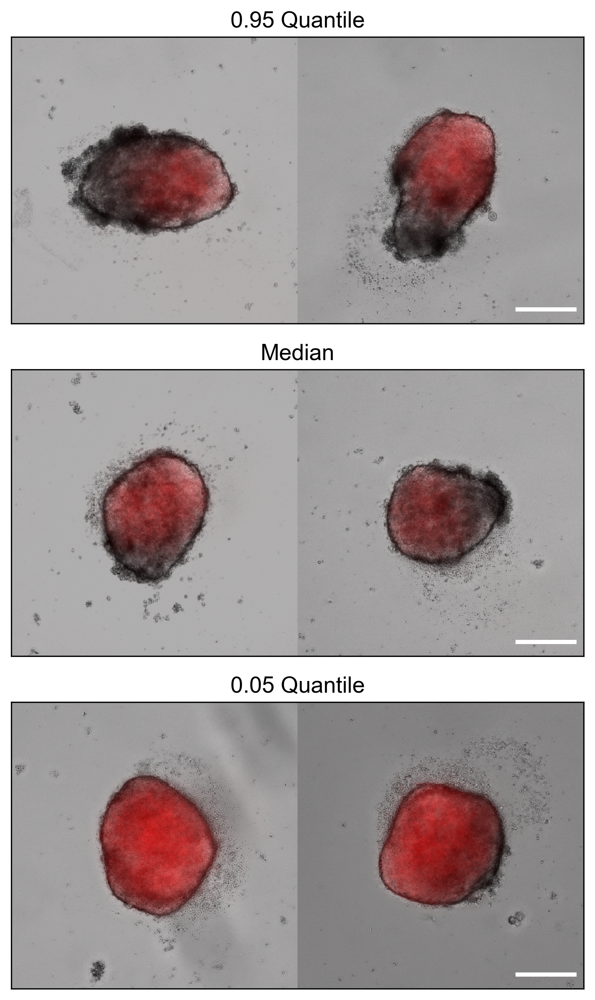

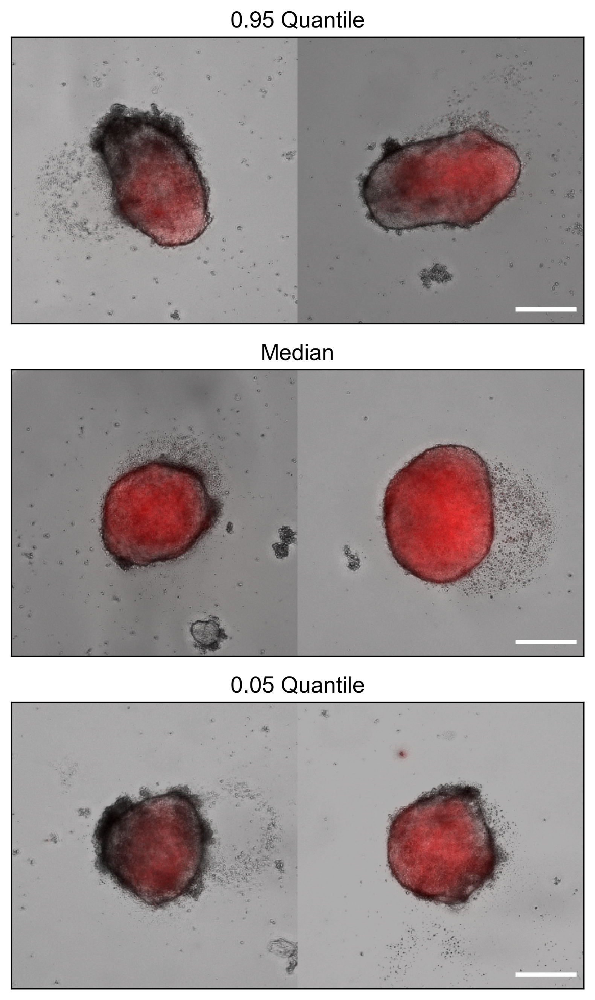

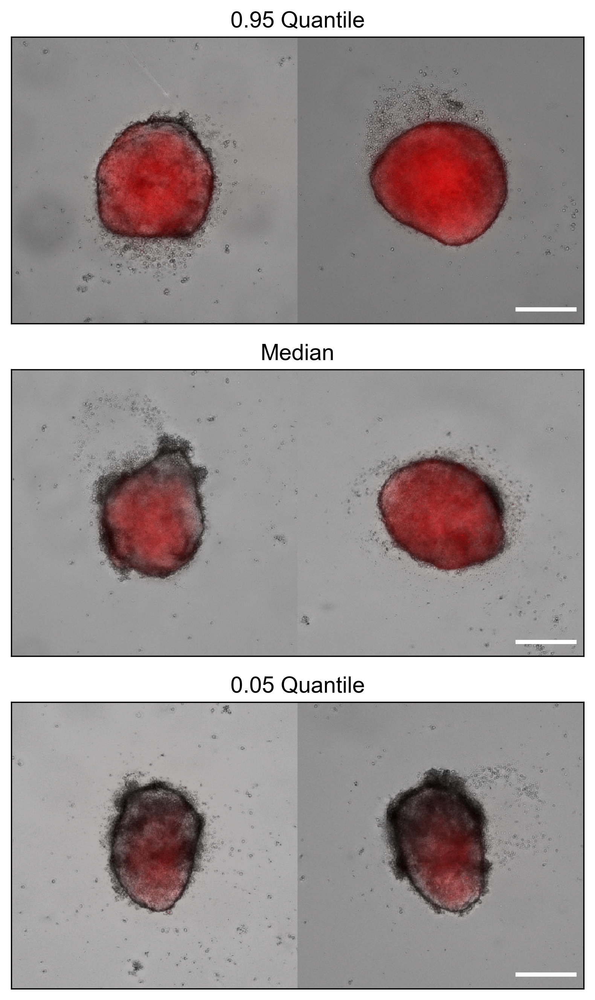

In [5]:
out_folder = home_directory + "/" + r"Plots\Example Structure Images"
features_PLSR = [
    '096h-[Radial Distribution Mean 3of9]-TmCH(mCH)',
    '096h-[Radial Distribution Mean 8of9]-TmCH(mCH)',
    '072h-[Mean Intensity]-TmCH(BF)',
    '096h-[Mean Intensity]-TmCH(BF)',
    '096h-[Mean Intensity]-TmCH(mCH)',
    '096h-[Area Fraction]-TmCH',
    '096h-[str Major Axis Polarisation]-TmCH',
    '096h-[str Aspect Ratio]-BF',
    '096h-[str Minor Axis Length]-BF',
]
data = data.rename(columns=name_mapping)
for feature in features_PLSR:
    make_example_structures_for_feature(
        data,
        feature,
        folder_96h=image_folder_96h_features,
        folder_72=image_folder_72h_features,
        out_folder=out_folder
    )